In [1]:
import os
import pandas as pd
from PIL import Image, ImageDraw
from ultralytics import YOLO
import numpy as np

In [2]:
def detect_objects(
    image,
    model_name="yolo11n.pt",
    return_results=False,
    project_dir="runs/detect",
    run_name="temp_run",
    show=False
):
    """
    Detect objects in an image using YOLO (supports standard and OBB models).

    Parameters
    ----------
    image : str or PIL.Image.Image
        Path to the image file or a PIL image.
    model_name : str
        YOLO model path or name.
    return_results : bool
        If True, also return the full YOLO results object.
    project_dir : str
        Directory to save results if save_results=True.
    run_name : str
        Subfolder name for the run.
    show : bool
        If True, draws bounding boxes on the image and returns the annotated image.

    Returns
    -------
    boxes_df : pd.DataFrame
        DataFrame with detection info.
        - Standard YOLO: ["class", "class_name", "confidence", "x1","y1","x2","y2"]
        - OBB YOLO: ["class_index", "class_name","x1","y1","x2","y2","x3","y3","x4","y4"]
    results : ultralytics.engine.results.Results (optional)
        Full YOLO results object if return_results=True.
    """
    # Detect if obb model and automatically save results because of YOLO behavior
    if "-obb" in model_name.lower():
        save_results = True
    else:
        save_results = False
    
    # Convert PIL to numpy array
    pil_image = None
    if isinstance(image, Image.Image):
        pil_image = image.copy()
        image = np.array(image)
    else:
        pil_image = Image.open(image)

    # Load model
    model = YOLO(model_name)

    # Run prediction
    results = model.predict(
        source=image,
        verbose=False,
        save=save_results,
        save_txt=save_results,
        project=project_dir,
        name=run_name
    )
    result = results[0]

    # First try standard boxes
    boxes = result.boxes
    if boxes is not None and boxes.data is not None and boxes.data.shape[0] > 0:
        # Standard YOLO boxes
        data = boxes.data.cpu().numpy()
        boxes_df = pd.DataFrame(
            data,
            columns=["x1","y1","x2","y2","confidence","class"]
        )
        boxes_df["class"] = boxes_df["class"].astype(int)
        boxes_df["class_name"] = boxes_df["class"].apply(lambda c: result.names.get(c, str(c)))
        boxes_df = boxes_df[["class","class_name","confidence","x1","y1","x2","y2"]]
    else:
        # Possibly OBB model — read .txt file if saved
        run_dir = os.path.join(project_dir, run_name, "labels")
        boxes_df = pd.DataFrame()
        
        if save_results and os.path.exists(run_dir):
            # Use the input image filename to pick the correct .txt
            image_name = os.path.basename(image if isinstance(image, str) else getattr(image, "filename", "image"))
            txt_name = os.path.splitext(image_name)[0] + ".txt"
            txt_file_path = os.path.join(run_dir, txt_name)

        if os.path.exists(txt_file_path):
            cols = ['class_index','x1','y1','x2','y2','x3','y3','x4','y4']
            boxes_df = pd.read_csv(txt_file_path, names=cols, sep=' ')
            boxes_df['class_name'] = boxes_df['class_index'].apply(lambda x: result.names.get(x, str(x)))
            if save_results and os.path.exists(run_dir):
                txt_files = [f for f in os.listdir(run_dir) if f.endswith(".txt")]
                if txt_files:
                    cols = ['class_index','x1','y1','x2','y2','x3','y3','x4','y4']
                    boxes_df = pd.read_csv(
                        os.path.join(run_dir, txt_files[0]),
                        names=cols, sep=' '
                    )
                    boxes_df['class_name'] = boxes_df['class_index'].apply(lambda x: result.names.get(x, str(x)))

    annotated_img = pil_image.copy() if show else None

    if show and boxes_df.shape[0] > 0:
        draw = ImageDraw.Draw(annotated_img)
        width, height = pil_image.size  # image dimensions for scaling OBB coords
    
        if "-obb" in model_name.lower():
            # Draw rotated boxes (OBB) with proper scaling
            for idx, row in boxes_df.iterrows():
                coords = [
                    (row['x1'] * width, row['y1'] * height),
                    (row['x2'] * width, row['y2'] * height),
                    (row['x3'] * width, row['y3'] * height),
                    (row['x4'] * width, row['y4'] * height),
                    (row['x1'] * width, row['y1'] * height)  # close the polygon
                ]
                coords = [(int(x), int(y)) for x, y in coords]
                draw.line(coords, width=2, fill="red")
                draw.text(coords[0], row['class_name'], fill="yellow")
        else:
            # Draw standard YOLO rectangles
            for idx, row in boxes_df.iterrows():
                x1, y1, x2, y2 = int(row['x1']), int(row['y1']), int(row['x2']), int(row['y2'])
                draw.rectangle([x1, y1, x2, y2], outline="red", width=2)
                draw.text((x1, y1), row['class_name'], fill="yellow")

    if return_results:
        print(results)
    if show:
        return (boxes_df, annotated_img)
    return boxes_df

In [3]:
# planes file came from here: https://zenodo.org/records/7331974#.Y4rPp3ZBwdV

In [4]:
img = Image.open("./planes-example.jpg")

In [5]:
boxes_df, example_image = detect_objects(img, "yolo11n.pt", False, show=True)

In [6]:
boxes_df

,class,class_name,confidence,x1,y1,x2,y2
0,4,airplane,0.879864,767.760010,1297.216553,1202.077515,1821.305176
1,4,airplane,0.863352,401.072876,1411.051147,716.072876,1791.712769
2,4,airplane,0.748343,3232.053467,713.842957,3464.571777,1023.306824
3,4,airplane,0.710245,1696.358765,1175.014771,2058.049561,1505.112183
4,4,airplane,0.698807,770.039978,1462.665161,1206.480469,1816.963013
5,4,airplane,0.676994,1921.208862,605.599670,2280.930420,926.849365
6,4,airplane,0.669176,3219.385010,1083.304810,3591.440430,1435.229858
7,4,airplane,0.579398,964.056885,774.532349,1302.368042,1207.239502
8,4,airplane,0.563135,2139.069580,325.059265,2511.054688,662.549133
9,4,airplane,0.548186,2664.806152,708.383728,2918.879639,1023.807861


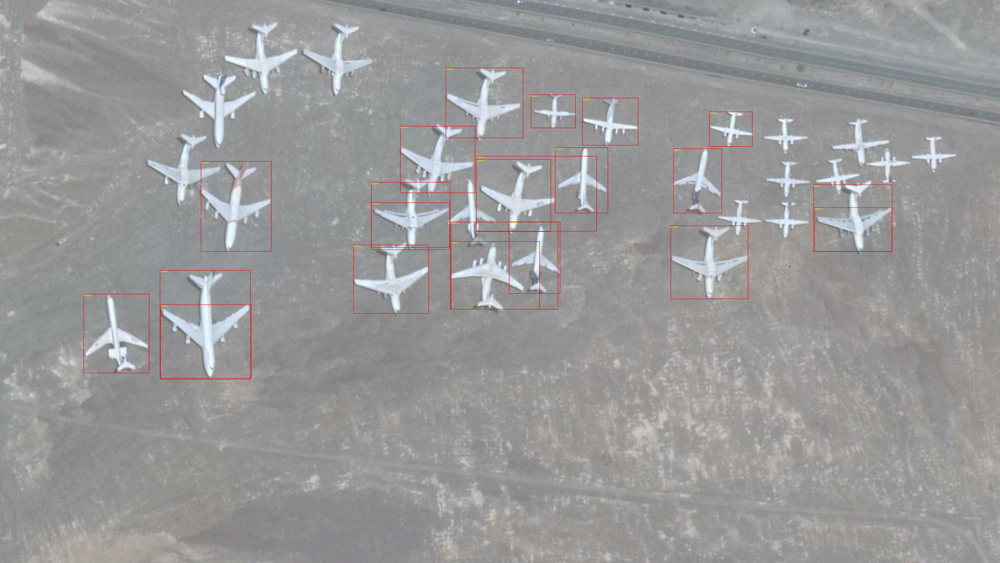

In [7]:
example_image

In [8]:
boxes_df2, example_image2 = detect_objects("./planes-example.jpg", "yolo11n-obb.pt", False, show=True)

Results saved to runs/detect/temp_run24
1 label saved to runs/detect/temp_run24/labels


In [9]:
boxes_df2

,class_index,x1,y1,x2,y2,x3,y3,x4,y4,class_name
0,0,0.748292,0.538272,0.751716,0.401046,0.670536,0.394658,0.667111,0.531884,plane
1,0,0.298561,0.169590,0.373693,0.177164,0.378005,0.042278,0.302873,0.034703,plane
2,0,0.300894,0.172855,0.301570,0.038865,0.223433,0.037623,0.222757,0.171613,plane
3,0,0.555435,0.427501,0.562321,0.288911,0.480581,0.276103,0.473695,0.414693,plane
4,0,0.521044,0.259792,0.525367,0.120314,0.446192,0.112574,0.441868,0.252053,plane
5,0,0.177466,0.257817,0.257249,0.265482,0.261574,0.123513,0.181792,0.115848,plane
6,0,0.219410,0.376212,0.226598,0.239687,0.147627,0.226577,0.140440,0.363101,plane
7,0,0.193520,0.443229,0.272847,0.446491,0.274882,0.290371,0.195556,0.287110,plane
8,0,0.392940,0.351878,0.473009,0.363366,0.479551,0.219577,0.399483,0.208089,plane
9,0,0.157618,0.672372,0.258475,0.673473,0.259136,0.482587,0.158279,0.481487,plane


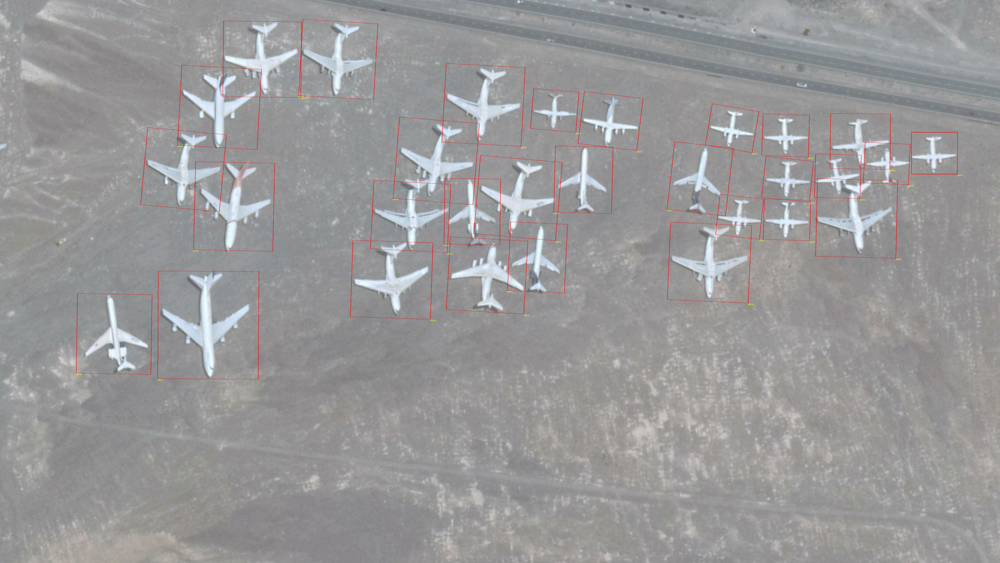

In [10]:
example_image2

In [11]:
boxes_df, annotated_img = detect_objects(
    "./Screenshot 2025-11-12 at 10.34.22 PM.png",
    model_name="yolo11l.pt",
    show=True,
    return_results=False
)

In [12]:
boxes_df

,class,class_name,confidence,x1,y1,x2,y2
0,4,airplane,0.717842,769.647705,73.241577,907.171448,225.160431
1,4,airplane,0.633283,343.440063,176.022598,497.923889,346.046356
2,4,airplane,0.575306,517.262512,196.428955,673.664978,377.359802
3,4,airplane,0.554941,463.412781,51.269104,600.264587,195.557846
4,4,airplane,0.453726,630.403625,70.885162,747.590210,201.611649
5,4,airplane,0.386289,217.302567,117.883293,332.648285,243.812103
6,14,bird,0.336340,711.419128,231.933289,868.731750,385.155426
7,4,airplane,0.334886,711.749939,231.997833,868.662720,384.578888
8,74,clock,0.330920,0.225488,267.400940,144.996750,484.283936
9,14,bird,0.277027,675.878906,411.369354,850.618469,579.309021


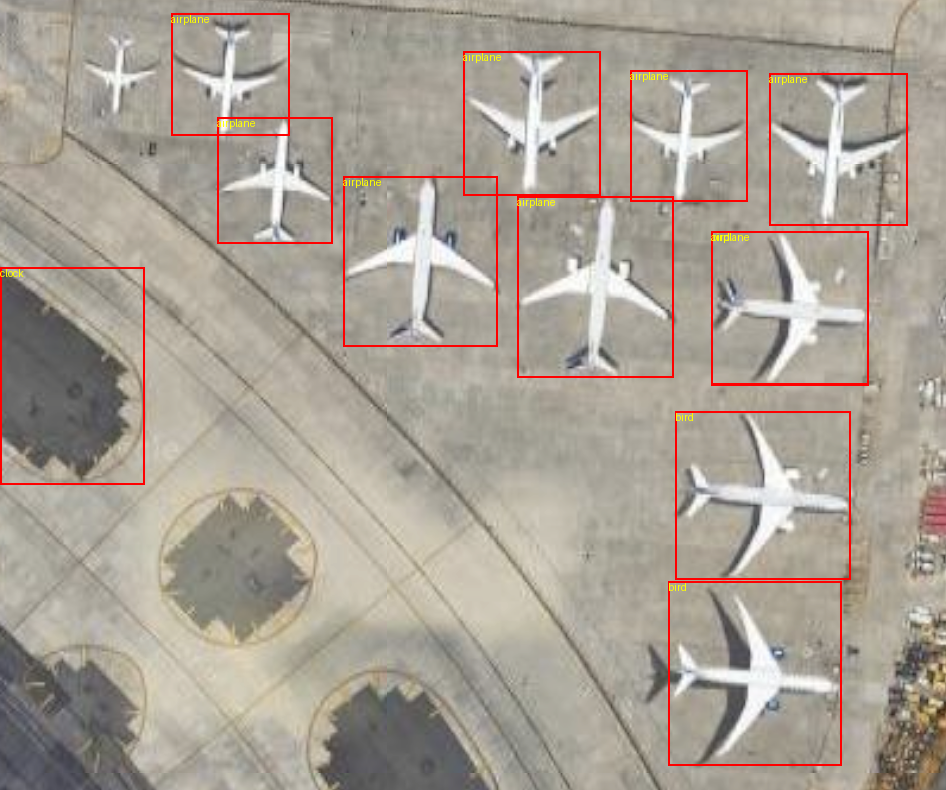

In [13]:
annotated_img

---

---

---